<a href="https://colab.research.google.com/github/Yuer707/ACTDR6-Colab/blob/main/ACT_DR6_maps.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DR6 maps

*Written by Cristian Vargas and the ACT Collaboration*

---

This notebook provides tools for visualizing maps from the most recent data release from the Atacama Cosmology Telescope (ACT). We primarily utilize the `pixell` library, enabling the loading, manipulation, and analysis of maps stored in rectangular pixelization, specifically designed for celestial maps such as Cosmic Microwave Background (CMB) intensity and polarization, binned galaxy positions, or shear maps in cylindrical projection. For Healpix maps, we employ the `healpy` library.

If you are not familiar with `pixell`, we recommend visiting the tutorial
notebooks at https://github.com/simonsobs/pixell_tutorials, especially the
notebook dealing with [map manipulation](https://github.com/simonsobs/pixell_tutorials/blob/master/Pixell_map_manipulation.ipynb).

In [1]:
# First install healpy and pixell, the rest of the libraries such as numpy
# and matplotlib should be included in colab

%%capture
!pip install healpy
!pip install pixell

In [ ]:
# Importing libraries

from pixell import enmap, utils, enplot,reproject
import numpy as np
import healpy as hp
import os
import matplotlib.patheffects as path_effects

In [ ]:
def eshow(x,**kwargs):
    ''' Function to help us plot the maps '''
    plots = enplot.get_plots(x, **kwargs)
    enplot.show(plots, method = "ipython")

### Let's start by downloading maps

In this notebook we will work with 150 GHz coadds across different arrays and seasons. But of course you can try other frequencies, specific arrays, night data only, etc. For details about the available maps read the maps paper and the descriptions available on LAMBDA.

One map that we will use is

`act_dr4dr6_coadd_AA_daynight_f150_map.fits`

The naming convention is the following: The first part means act only, `dr4dr6` means this is a coadding of the previous DR4 data en the newest DR6, `coadd` means that combines all arrays at f150, `AA` is the wide survey `daynight` is the combination of night and day data

The other map that we will use is

`act-planck_dr4dr6_coadd_AA_daynight_f150_map.fits`

Here the difference is the inclusion of `planck` in the first part of the file name.

This may take ~5 min!

In [ ]:
#Here we download the map using wget, this is hosted on phy-ac1.princeton.edu
#The full release is available on LAMBDA https://lambda.gsfc.nasa.gov/

!wget https://phy-act1.princeton.edu/public/data/dr6_maps_v1/act_dr4dr6_coadd_AA_daynight_f150_map.fits
!wget https://phy-act1.princeton.edu/public/data/dr6_maps_v1/act-planck_dr4dr6_coadd_AA_daynight_f150_map.fits

--2025-03-24 03:16:20--  https://phy-act1.princeton.edu/public/data/dr6_maps_v1/act_dr4dr6_coadd_AA_daynight_f150_map.fits
Resolving phy-act1.princeton.edu (phy-act1.princeton.edu)... 128.112.102.238
Connecting to phy-act1.princeton.edu (phy-act1.princeton.edu)|128.112.102.238|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5349890880 (5.0G) [image/fits]
Saving to: ‘act_dr4dr6_coadd_AA_daynight_f150_map.fits’

act_dr4dr6_coadd_AA 100%[===================>]   4.98G  45.9MB/s    in 2m 15s  

2025-03-24 03:18:35 (37.8 MB/s) - ‘act_dr4dr6_coadd_AA_daynight_f150_map.fits’ saved [5349890880/5349890880]

--2025-03-24 03:18:35--  https://phy-act1.princeton.edu/public/data/dr6_maps_v1/act-planck_dr4dr6_coadd_AA_daynight_f150_map.fits
Resolving phy-act1.princeton.edu (phy-act1.princeton.edu)... 128.112.102.238
Connecting to phy-act1.princeton.edu (phy-act1.princeton.edu)|128.112.102.238|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5349890880

In [ ]:
# We load the file using enmap

factplanck150 = 'act-planck_dr4dr6_coadd_AA_daynight_f150_map.fits'
mactplanck150 = enmap.read_map(factplanck150)

In [ ]:
# We can inspect the wcs and size
print(mactplanck150.shape)
print(mactplanck150.wcs)

(3, 10320, 43200)
car:{cdelt:[-0.008333,0.008333],crval:[0,0],crpix:[21601.00,7560.50]}


The shape of the file is 3, 10320, 43200 meaning 3 maps, Intensity, Polarization Q, Polarization U. Each one has 10320 pixels on declination, and 43200 on right ascension.

The wcs explains that the pixelization scheme which is plate carreé, meaning all pixels have the same width and height of 0.08333 degrees or 0.5 arcminutes.

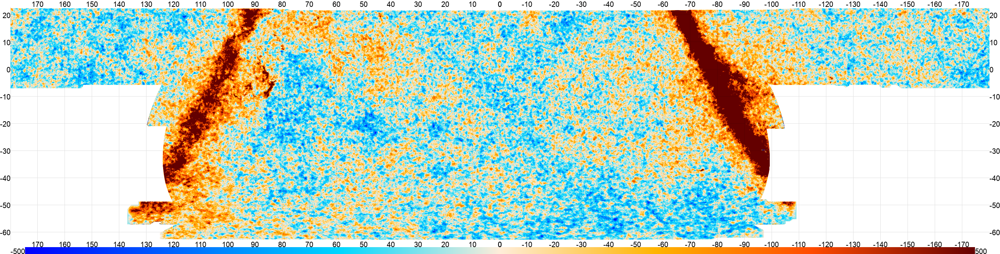

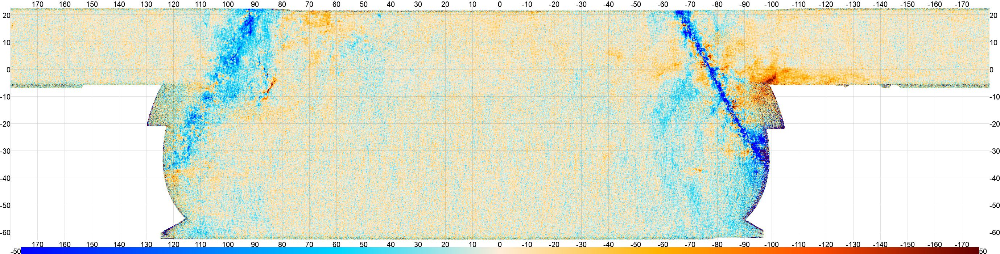

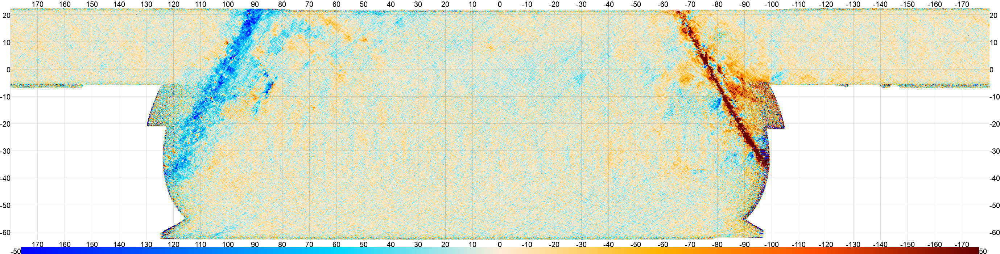

In [ ]:
# To plot we use a params dictionary and the function eshow defined above

#In the params we choose the colorbar, we downgrade the maps by a factor of 16
#since we are using the full footprint, we choose a range of -500 to 500 uK
#for the Intensity map, and a range of -50 to 50 uK for the Polarization maps
#show ticks every 10 degrees, no mask, and colorbar is included

#This plots the three maps, if you want just one component for example
#Intensity you can use `eshow(mactplanck150[0], **params)` but be sure
#to use `range = 500` in params

params = {"color":"planck", "downgrade":16, "range":[500,50], "ticks":10,
          "mask":0, "colorbar":True}
eshow(mactplanck150, **params)

#To avoid using too much RAM we delete the map after plotting it
del mactplanck150

At these scales what dominates is Planck data. We can see this for example if we plot act only data

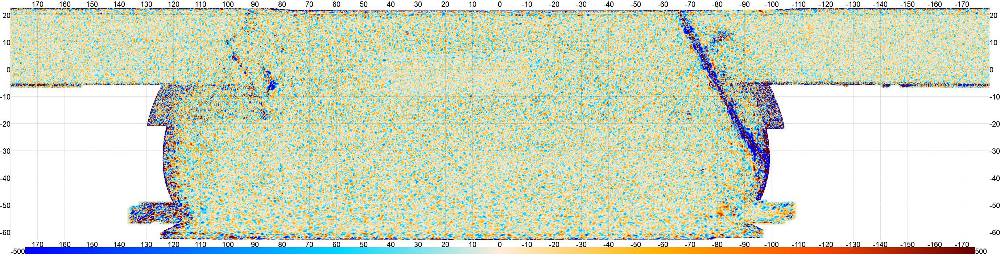

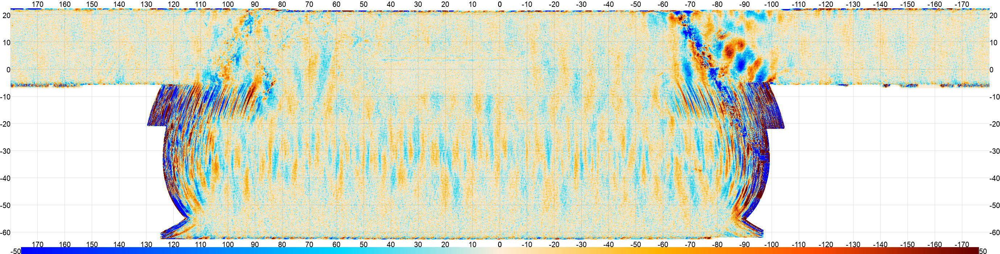

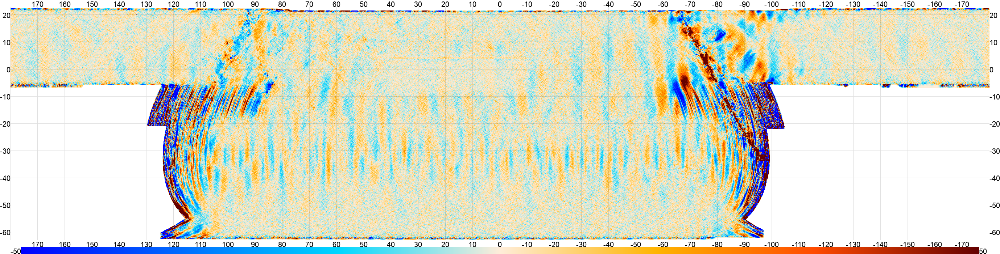

In [ ]:
fact = 'act_dr4dr6_coadd_AA_daynight_f150_map.fits'
mact = enmap.read_map(fact)

params = {"color":"planck", "downgrade":16, "range":[500,50], "ticks":10, "mask":0, "colorbar":True}
eshow(mact, **params)

#To avoid using too much RAM we delete the map after plotting it
del mact

Now let's do a zoom on temperature on a few square degrees

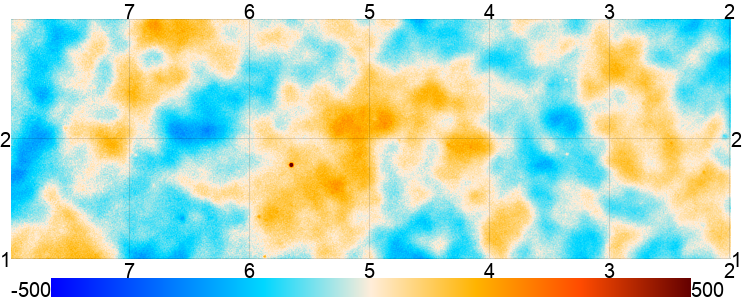

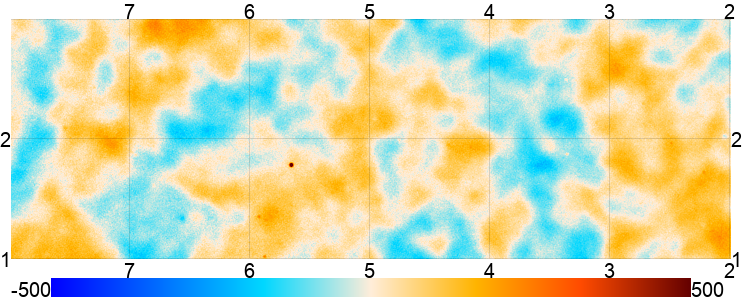

In [ ]:
# First we need to define our coordinates and width in radians
# (utils.degree converts degrees to radians)

ra = 5. * utils.degree
dec = 2. * utils.degree
width = 6 * utils.degree
height = 2 * utils.degree

# We can define a rectangular box in the following way

box = np.array([[dec - height/2, ra - width/2], [dec + height/2, ra + width/2]])

# Then load intensity on that box

factplanck150 = 'act-planck_dr4dr6_coadd_AA_daynight_f150_map.fits'
mactplanck150_sub = enmap.read_map(factplanck150,box=box)[0]

fact150 = 'act_dr4dr6_coadd_AA_daynight_f150_map.fits'
mact150_sub = enmap.read_map(fact150,box=box)[0]

# Alternatively we can load the full maps and generate the box from them
# in that case the code would be the following. NOTE this uses more than
# 13 GB RAM so it will not load on colab, the code is the following:

#factplanck150 = 'act-planck_dr4dr6_coadd_AA_daynight_f150_map.fits'
#mactplanck150 = enmap.read_map(factplanck150)[0]
#mactplanck150_sub = mactplanck150.submap(box)
#fact150 = 'act-planck_dr4dr6_coadd_AA_daynight_f150_map.fits'
#mact150 = enmap.read_map(fact150,box=box)[0]
#mact150_sub = mact150.submap(box)

# The advantage of the commented code above is that you can cut
# multiple submaps, we will explore that later.

# Visualize the sub map ACT+Planck in temperature
plot = enplot.plot(mactplanck150_sub,range=500,colorbar=True)
enplot.show(plot)

# Visualize the sub map ACT in temperature
plot = enplot.plot(mact150_sub,range=500,colorbar=True)
enplot.show(plot)

Note that they look pretty similar at the degree scale. For healpix maps we use `healpy`, we can load and plot healpix maps using that library. We strongly recommend using the CAR versions for all analysis, as they represent the native pixelization of the maps. However, Healpix versions offer valuable advantages for visualizing the survey footprint against the full sky. Furthermore, reprojecting full-sky Healpix maps to the CAR footprint is beneficial for generating masks and performing comparative studies

Here to show an example, we downgrade the ACT+Planck map and reproject it to healpix nside 1024. The DR6 release healpix maps are a reprojection to nside 8192. For details read the documentation of `reproject` on `pixell`


In [ ]:
# First we downgrade the maps, this is not necessary but a full resolution
# reprojection requires more resources

factplanck150 = 'act-planck_dr4dr6_coadd_AA_daynight_f150_map.fits'
mactplanck150 = enmap.read_map(factplanck150)

mactplanck150 = enmap.downgrade(mactplanck150,16, op=np.mean, ref=None,
                                             off=None, inclusive=False)


# Using map2healpix from reproject, then we write the file

hpm = reproject.map2healpix(mactplanck150, nside=1024, lmax=6000, out=None,
                            rot=None, spin=[0,2], method="spline", order=0,
                            extensive=False, bsize=100000, nside_mode="pow2",
                            boundary="constant", verbose=False)
hp.fitsfunc.write_map("actplanck_f150_hpm_1048.fits", hpm,overwrite=True)

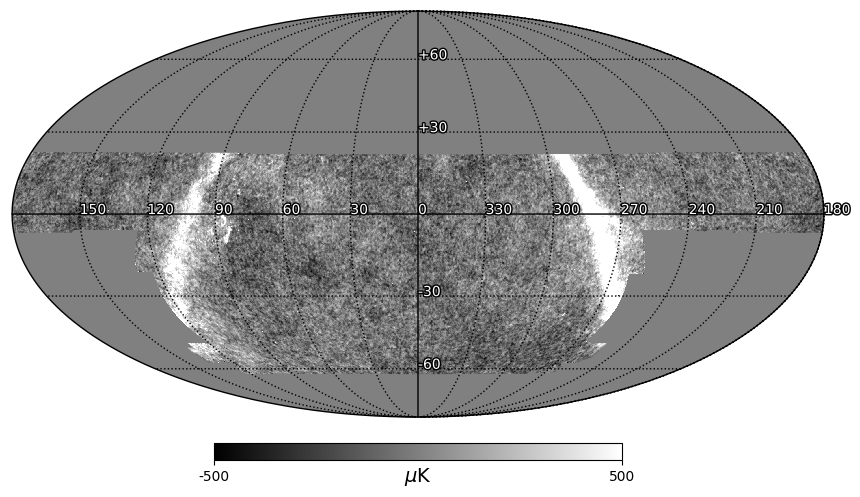

In [ ]:
#Now we read the file and plot the data in molweide projection

hpm = hp.read_map("actplanck_f150_hpm_1048.fits")

hp.visufunc.mollview(hpm,min=-500,max=500,cmap="gray",coord="C",
                 title="",unit=r"$\mu$K",notext=True,xsize=2000)

#adding labels manually

incolor = "white"
fgcolor = "black"
lw = 2

# Horizontal labels
lon_values = [0, 30, 60, 90, 120, 150, 180, 210, 240, 270, 300, 330]
for lon in lon_values:
    text_label = str(lon)
    hp.visufunc.projtext(lon, 0.0, text_label, lonlat=True, coord="C",
        color=incolor).set_path_effects([path_effects.Stroke(linewidth=lw,
        foreground=fgcolor),path_effects.Normal()])

# Vertical labels at lon=0
lat_values_0 = [30, 60, -30, -60]
for lat in lat_values_0:
    text_label = f"{'+' if lat > 0 else '-'}{abs(lat)}"
    hp.visufunc.projtext(0.0, lat, text_label, lonlat=True, coord="C",
        color=incolor).set_path_effects([path_effects.Stroke(linewidth=lw,
        foreground=fgcolor),path_effects.Normal()])

hp.graticule()

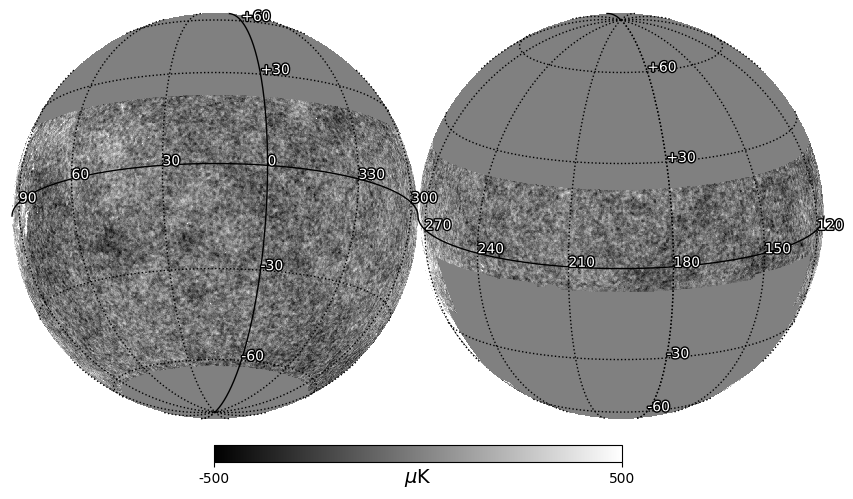

In [ ]:
# And in orthview, this orientation enhances regions outside the galactic plane

hp.visufunc.orthview(hpm,min=-500,max=500,cmap="gray",coord="C",rot=[15,-15],
                              title="",unit=r"$\mu$K",notext=True,xsize=2000)
hp.graticule()

#adding labels manually

incolor = "white"
fgcolor = "black"
lw = 2

# Horizontal labels
lon_values = [0, 30, 60, 90, 120, 150, 180, 210, 240, 270, 300, 330]
for lon in lon_values:
    text_label = str(lon)
    hp.visufunc.projtext(lon, 0.0, text_label, lonlat=True, coord="C",
        color=incolor).set_path_effects([path_effects.Stroke(linewidth=lw,
        foreground=fgcolor),path_effects.Normal()])

# Vertical labels at lon=0
lat_values_0 = [30, 60, -30, -60]
for lat in lat_values_0:
    text_label = f"{'+' if lat > 0 else '-'}{abs(lat)}"
    hp.visufunc.projtext(0.0, lat, text_label, lonlat=True, coord="C",
        color=incolor).set_path_effects([path_effects.Stroke(linewidth=lw,
        foreground=fgcolor),path_effects.Normal()])

# Vertical labels at lon=180
lat_values_180 = [30, 60, -30, -60]
for lat in lat_values_180:
    text_label = f"{'+' if lat > 0 else '-'}{abs(lat)}"
    hp.visufunc.projtext(180.0, lat, text_label, lonlat=True, coord="C",
        color=incolor).set_path_effects([path_effects.Stroke(linewidth=lw,
        foreground=fgcolor), path_effects.Normal()])



Going back to the CAR maps, let's zoom on some cool objects. There are several galactic and extragalactic objects inside the footprint. We can start with some galactic regions.

For example the Orion molecular complex is located around ra = 85, dec = -8 and it is visible in the full survey

In [ ]:
# For galactic object we use the combined map

factplanck150 =  'act-planck_dr4dr6_coadd_AA_daynight_f150_map.fits'
mactplanck150 = enmap.read_map(factplanck150)

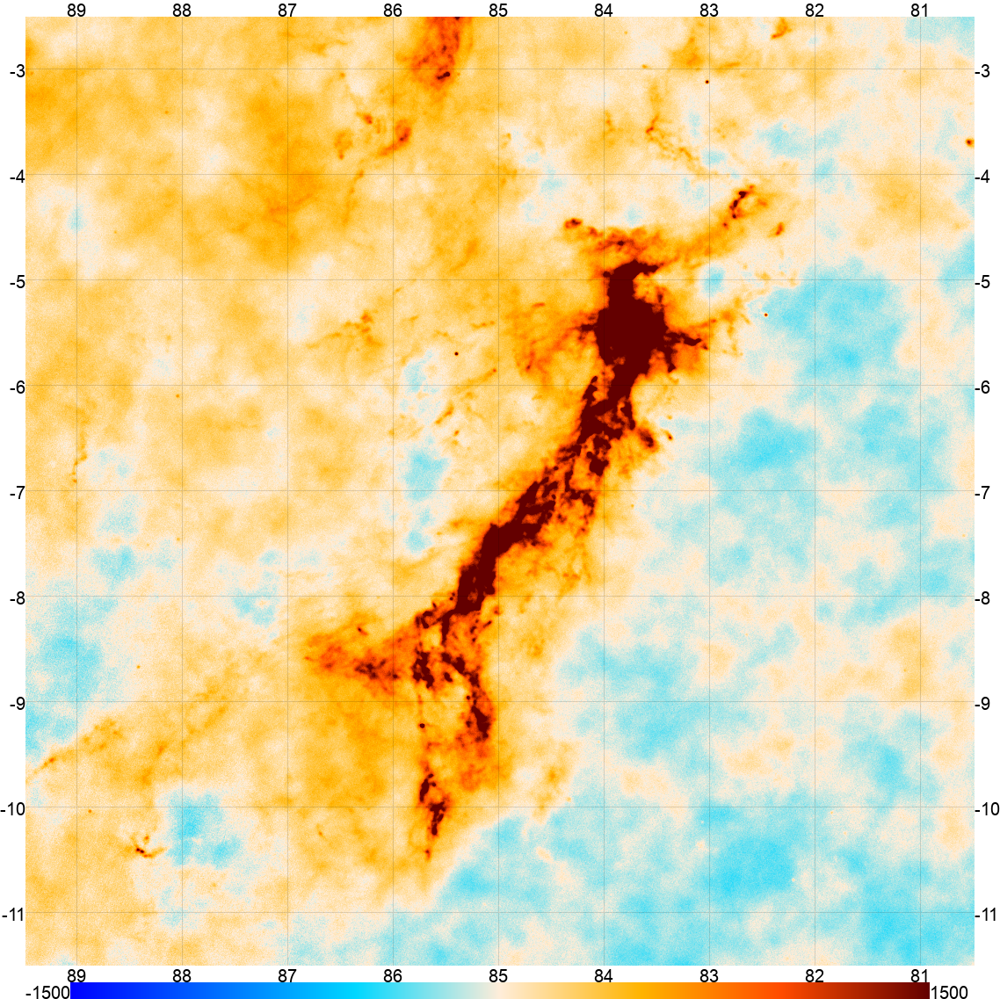

In [ ]:
ra = 85. * utils.degree
dec = -7. * utils.degree
width = 9. * utils.degree

box = np.array([[dec - width/2, ra - width/2], [dec + width/2, ra + width/2]])

mactplanck150_sub = mactplanck150.submap(box)

plot = enplot.plot(mactplanck150_sub[0],range=1500,colorbar=True)
enplot.show(plot)

Corona Australis is located around ra = -85 dec = -40

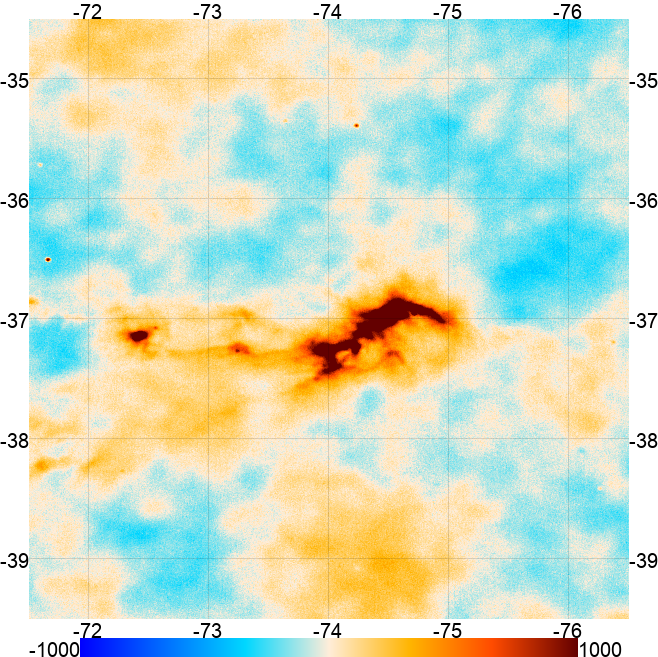

In [ ]:
ra = -74. * utils.degree
dec = -37. * utils.degree
width = 5 * utils.degree

box = np.array([[dec - width/2, ra - width/2], [dec + width/2, ra + width/2]])

mactplanck150_sub = mactplanck150.submap(box)

plot = enplot.plot(mactplanck150_sub[0],range=1000,colorbar=True)
enplot.show(plot)

The Rossette Nebula is also visible! This H II region is located on ra = 98 dec = 4.9

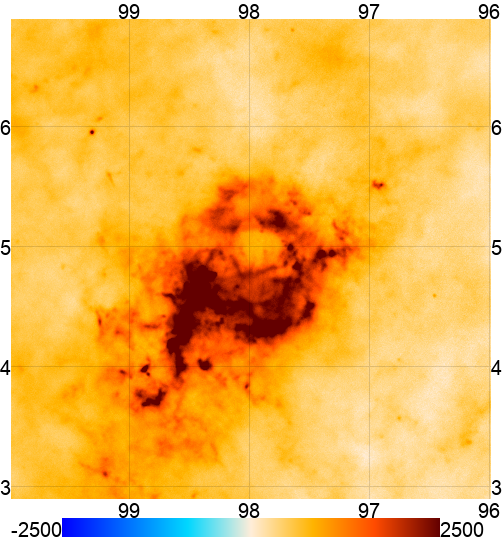

In [ ]:
ra = 98.0 * utils.degree
dec = 4.9 * utils.degree
width = 4 * utils.degree

box = np.array([[dec - width/2, ra - width/2], [dec + width/2, ra + width/2]])

mactplanck150_sub = mactplanck150.submap(box)

plot = enplot.plot(mactplanck150_sub[0],range=2500,colorbar=True)
enplot.show(plot)

Now moving onto extragalactic sources, there are thousands of nearby galaxies inside the ACT footprint, a few of them are close enough to see their shape, i.e. they are not point sources. To show an example this is the Silver Coin Galaxy ra = 11.9 dec = -25.3

In [ ]:
# Here we switch to act only

del mactplanck150

fact150 =  'act_dr4dr6_coadd_AA_daynight_f150_map.fits'
mact150 = enmap.read_map(fact150)

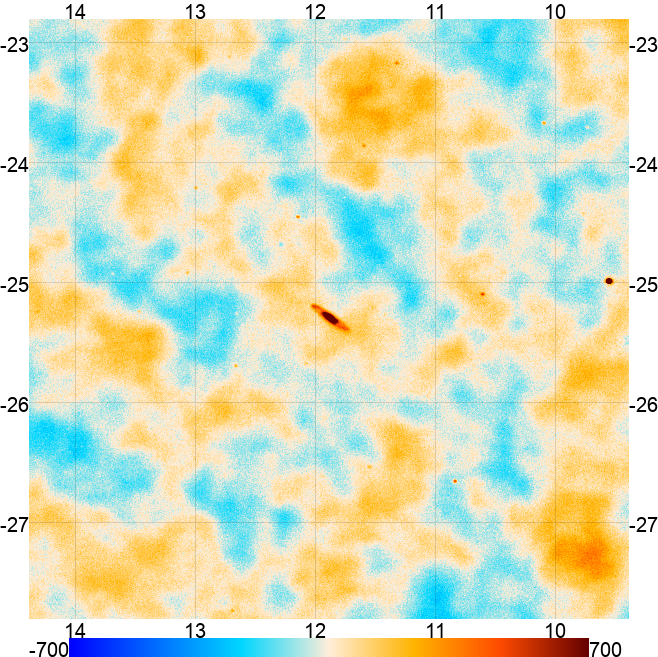

In [ ]:
ra = 11.9 * utils.degree
dec = -25.3 * utils.degree
width = 5 * utils.degree

box = np.array([[dec - width/2, ra - width/2], [dec + width/2, ra + width/2]])

mact150_sub = mact150.submap(box)

plot = enplot.plot(mact150_sub[0],range=700,colorbar=True)
enplot.show(plot)

But in general, galaxies are not resolved and thus they show as points in the maps. If you cut any big region you will see lots of them. For example let's try a region far away from the Galactic plane e.g. ra = 157 dec = 5 and cut a rectangle. Point sources are easier to spot using a gray scale also.

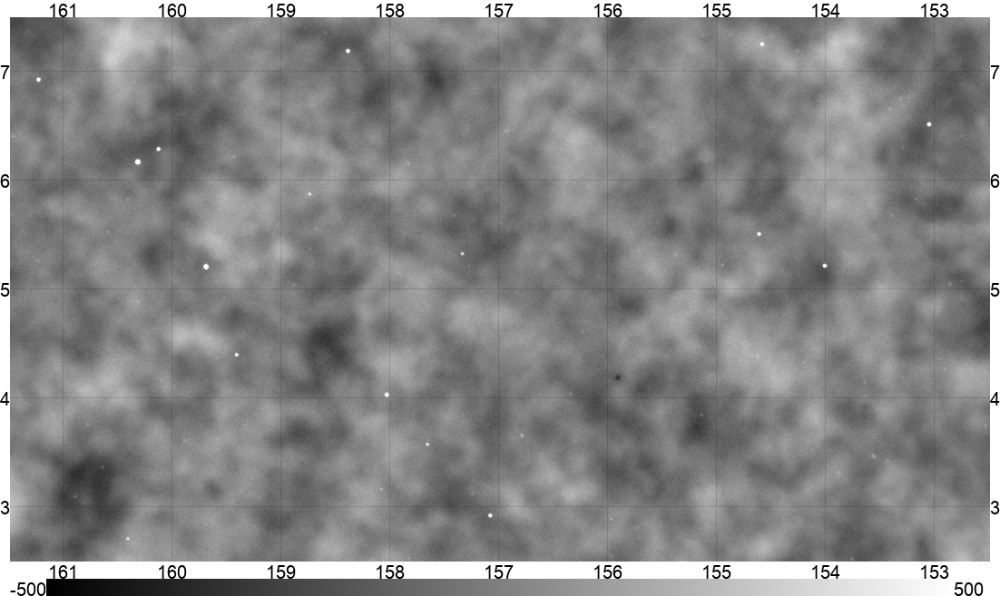

In [ ]:
ra = 157. * utils.degree
dec = 5. * utils.degree
width = 9 * utils.degree
height = 5 * utils.degree

box = np.array([[dec - height/2, ra - width/2], [dec + height/2, ra + width/2]])

mact150_sub = mact150.submap(box)

plot = enplot.plot(mact150_sub[0],range=500,color="gray",colorbar=True)
enplot.show(plot)


As you can see there are lots of bright dots, these are usually Active Galactic Nuclei. On that same image we can spot by eye a decrement (or negative brightness source) near ra = 156 and dec = 4. This is a galaxy cluster showing as decrement due to the thermal Sunyaev Zel'dovich effect. For example a massive cluster is the Bullet Cluster located at ra = 104.64 dec = -55.97. We can do a zoom on the loaded 150 GHz map.

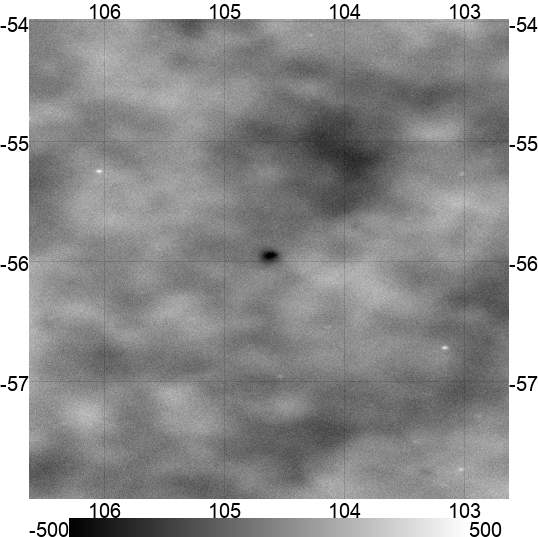

In [ ]:
ra = 104.64 * utils.degree
dec = -55.97 * utils.degree
width = 4 * utils.degree

box = np.array([[dec - width/2, ra - width/2], [dec + width/2, ra + width/2]])

mact150_sub = mact150.submap(box)

plot = enplot.plot(mact150_sub[0],range=500,colorbar=True,color="gray")
enplot.show(plot)

Note the horizontal stretching is a projection effect due to the high declination in the rectangular projection. While this does not matter for spherical harmonic transforms, for map-based studies of point sources, like stacks, it can be useful to counteract. An example of how to do this can be found in the ACT DR6 notebook on [ymap stacking](https://github.com/ACTCollaboration/DR6_Notebooks/blob/main/ACT_DR6_ymap_stacking.ipynb).

Another massive cluster is El Gordo located at ra = 15.73 dec = -49.26

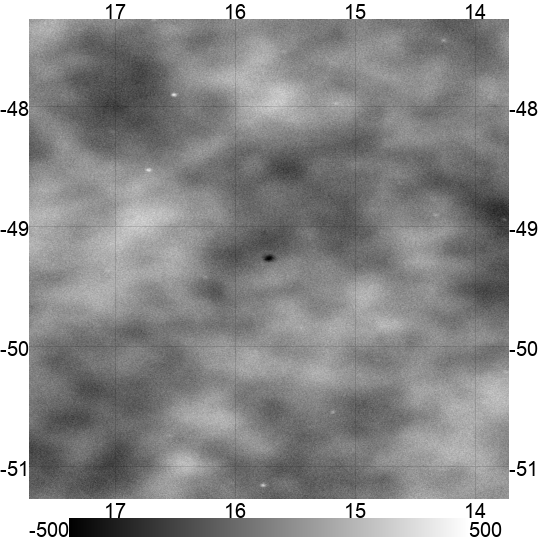

In [ ]:
ra = 15.73 * utils.degree
dec = -49.26 * utils.degree
width = 4 * utils.degree

box = np.array([[dec - width/2, ra - width/2], [dec + width/2, ra + width/2]])

mact150_sub = mact150.submap(box)

plot = enplot.plot(mact150_sub[0],range=500,colorbar=True,color="gray")
enplot.show(plot)

Finally lets inspect polarization Q and U Stokes parameters

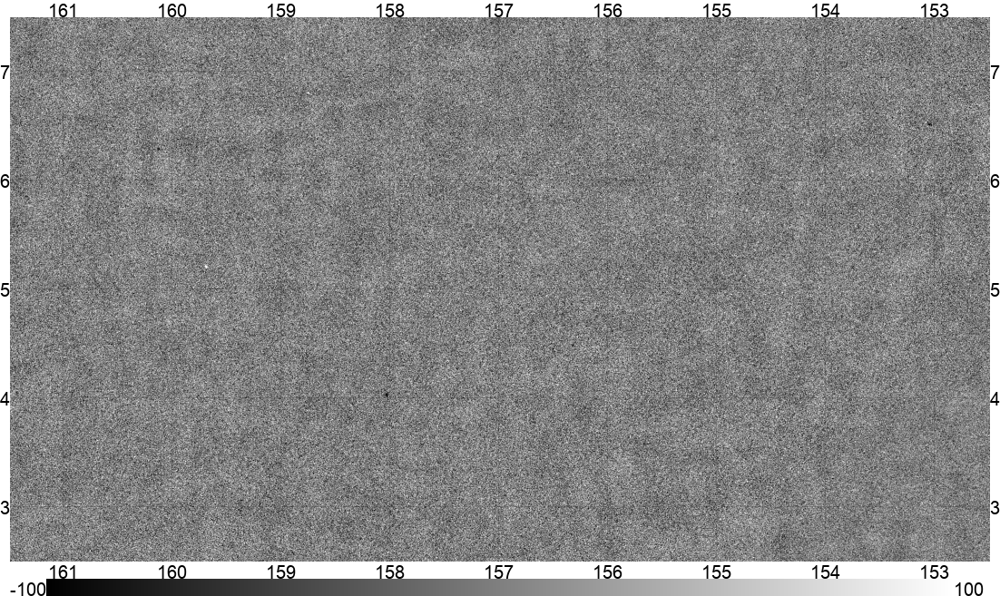

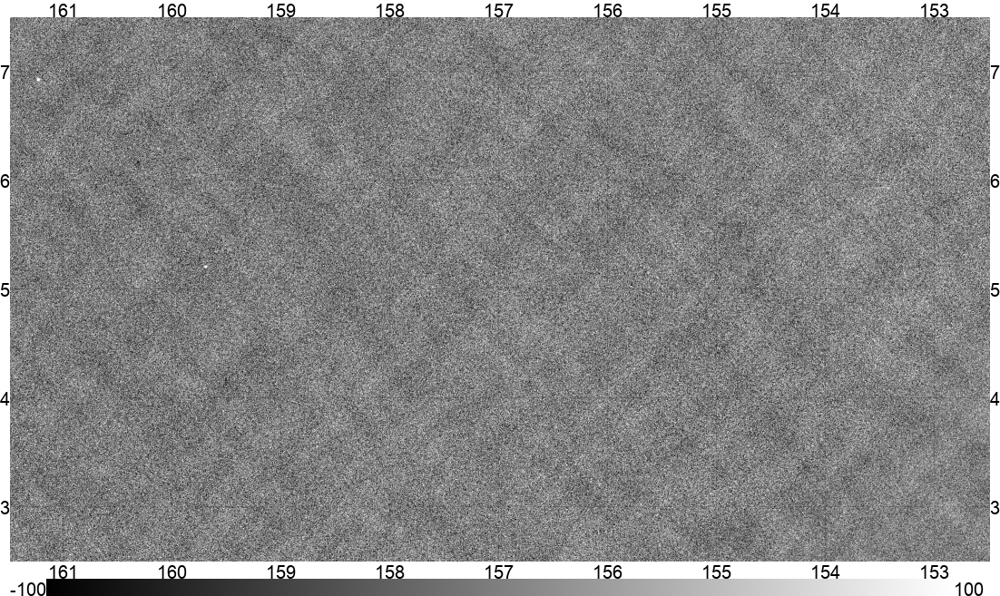

In [ ]:
ra = 157. * utils.degree
dec = 5. * utils.degree
width = 9 * utils.degree
height = 5 * utils.degree

box = np.array([[dec - height/2, ra - width/2], [dec + height/2, ra + width/2]])

Q_sub = mact150.submap(box)[1]
U_sub = mact150.submap(box)[2]

plot = enplot.plot(Q_sub,range=100,color="gray",colorbar=True)
enplot.show(plot)
plot = enplot.plot(U_sub,range=100,color="gray",colorbar=True)
enplot.show(plot)

It's possible to see by eye the _ | patterns on Q and the / \ which means that the sky is dominated by E modes!

We can view the E and B modes directly with a spin-2 transform followed by a spin-0 transform. We see signal-dominated E modes, but the B modes just look like white noise.

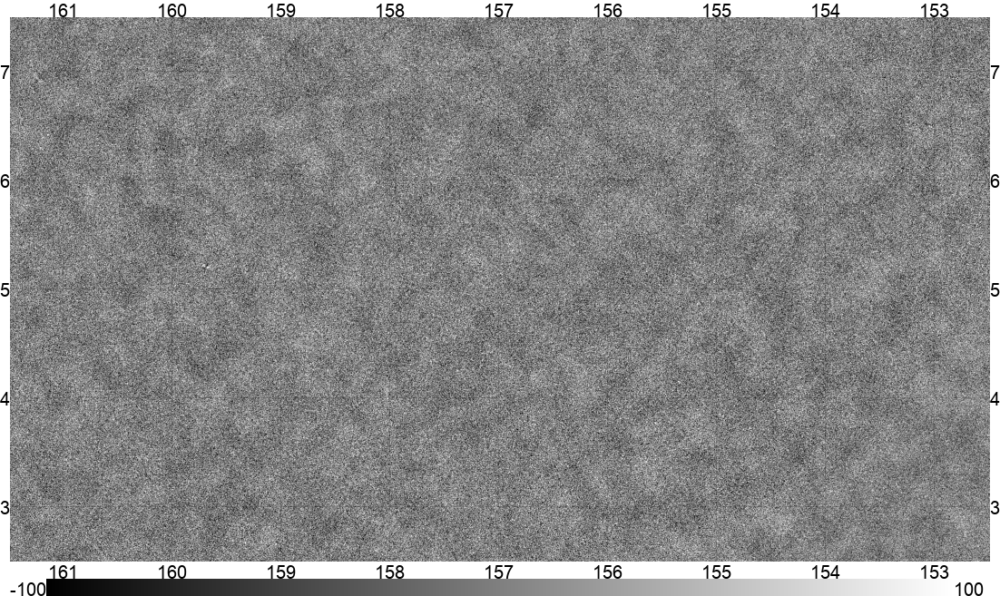

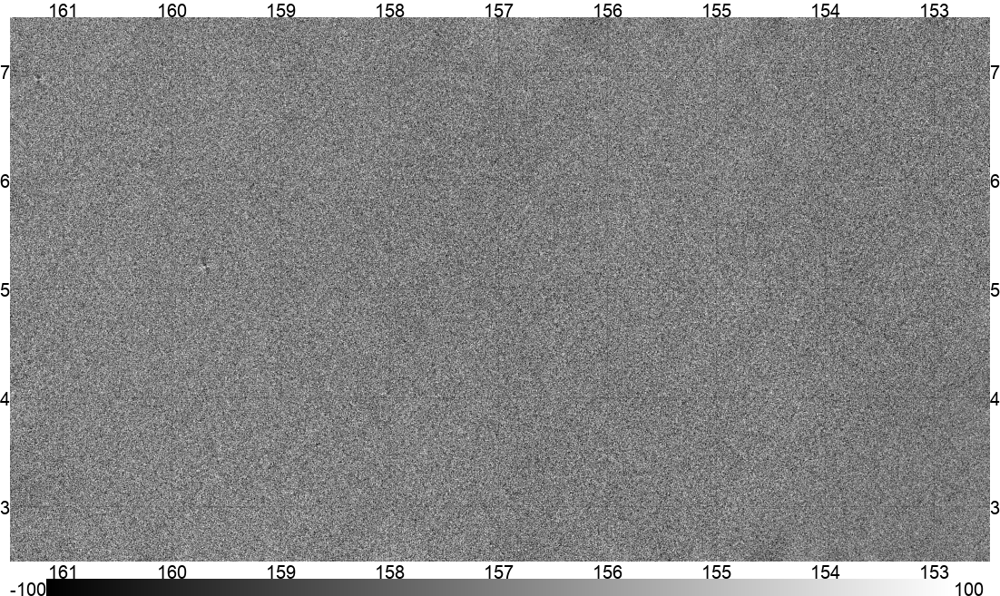

In [ ]:
E_sub, B_sub = enmap.harm2map(enmap.map2harm(mact150.submap(box)[1:], spin=2), spin=0)

plot = enplot.plot(E_sub,range=100,color="gray",colorbar=True)
enplot.show(plot)
plot = enplot.plot(B_sub,range=100,color="gray",colorbar=True)
enplot.show(plot)